In [1]:
%matplotlib notebook
from pathlib import Path
import nibabel as nib
import matplotlib.pyplot as plt
import numpy as np
from celluloid import Camera
from IPython.display import HTML

## Dataset Creation
We can loop over all available scans and add them to the subject list

In [2]:
from pathlib import Path
import torchio as tio

# --- Base split root ---
BASE = Path(r"E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split")

def change_img_to_label_path(p: Path) -> Path:
    """
    Map:
      .../image/Lung_xxx_0000.nii.gz  -->  .../label_gtvp/Lung_xxx.nii.gz
    """
    if p.parent.name != "image":
        raise ValueError(f"Expected parent folder named 'image', got: {p.parent}")
    label_dir = p.parent.with_name("label_gtvp")
    name = p.name
    if name.endswith("_0000.nii.gz"):
        name = name[:-len("_0000.nii.gz")] + ".nii.gz"
    else:
        name = name.replace("_0000", "")
        if not name.endswith(".nii.gz"):
            name += ".nii.gz"
    return label_dir / name

In [3]:
def build_subjects(split_dir: Path, require_label: bool = True):
    """
    Create TorchIO subjects from a split directory (train/val/test).
    If require_label=False, subjects without labels are still created (CT only).
    """
    image_paths = sorted(split_dir.rglob(r"image/Lung_*_0000.nii.gz"))
    subjects, missing = [], 0

    for img_path in image_paths:
        lab_path = change_img_to_label_path(img_path)
        if lab_path.exists():
            subjects.append(
                tio.Subject(
                    CT=tio.ScalarImage(img_path),
                    Label=tio.LabelMap(lab_path),
                )
            )
        else:
            missing += 1
            if require_label:
                print(f"[WARN] Missing label for: {img_path.name} -> {lab_path.name}")
                continue
            # Test-time without labels:
            subjects.append(tio.Subject(CT=tio.ScalarImage(img_path)))

    print(f"[{split_dir.name}] Built {len(subjects)} subjects (missing labels: {missing})")
    return subjects

# --- Build each split ---
full_subjects = build_subjects(BASE / "full", require_label=True)
# val_subjects   = build_subjects(BASE / "val",   require_label=True)
# test_subjects  = build_subjects(BASE / "test",  require_label=True)  # flip to True if you do have test labels

[full] Built 150 subjects (missing labels: 0)


In [4]:
for subject in full_subjects:
    assert subject["CT"].orientation == ("L", "P", "S")

## Compute tumor volume per Subject

In [5]:
import numpy as np

# Assume:
# - full_subjects is a Python list of tio.Subject
# - each subject has keys 'CT' and 'Label'
# - tumor voxels in Label == 1  (change if your label value is different)

tumor_volumes = []

for s in full_subjects:
    lbl = s['Label']               # TorchIO Image
    data = lbl.data                # tensor shape (1, W, H, D) or (1, D, H, W)
    spacing = lbl.spacing          # (sx, sy, sz) in mm
    
    # voxel volume in cubic centimeters
    voxel_vol_cc = (spacing[0] * spacing[1] * spacing[2]) / 1000.0
    
    # count tumor voxels (assuming label==1 is tumor)
    tumor_voxels = (data == 1).sum().item()
    tumor_volume_cc = tumor_voxels * voxel_vol_cc
    
    tumor_volumes.append(tumor_volume_cc)

tumor_volumes = np.array(tumor_volumes)  # shape (N,)
N = len(full_subjects)
print("N subjects:", N)

N subjects: 150


<IPython.core.display.Javascript object>


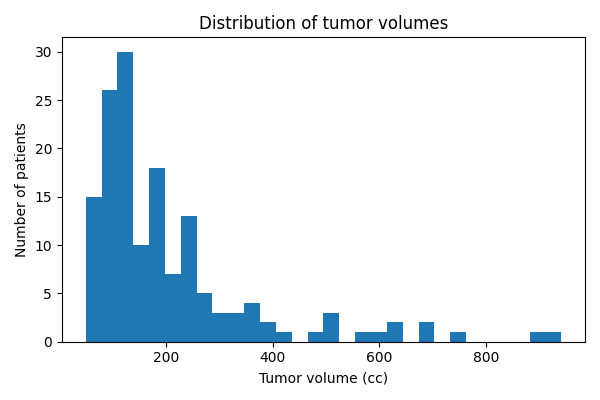

In [6]:
import matplotlib.pyplot as plt

# Basic histogram
plt.figure(figsize=(6,4))
plt.hist(tumor_volumes, bins=30)
plt.xlabel("Tumor volume (cc)")
plt.ylabel("Number of patients")
plt.title("Distribution of tumor volumes")
plt.tight_layout()
plt.show()

In [7]:
print("Min:", tumor_volumes.min())
print("Max:", tumor_volumes.max())
print("Median:", np.median(tumor_volumes))
print("Mean:", tumor_volumes.mean())

Min: 49.538612365722656
Max: 941.253662109375
Median: 152.17369079589844
Mean: 206.68959884643556


## Make simple volume bins for stratification
Here we use 3 bins (tertiles): small / medium / large.

In [8]:
# Compute tertile cut points
q1 = np.quantile(tumor_volumes, 1/3)
q2 = np.quantile(tumor_volumes, 2/3)

# Assign bin labels 0, 1, 2
tv_bins = np.zeros(N, dtype=int)
tv_bins[tumor_volumes >  q1] = 1
tv_bins[tumor_volumes >  q2] = 2

# Optional: store bin in the Subject itself (handy for debugging)
for i, s in enumerate(full_subjects):
    s['tv_bin'] = int(tv_bins[i])

# Quick sanity check
(unique, counts) = np.unique(tv_bins, return_counts=True)
print("Bin counts:", dict(zip(unique, counts)))

Bin counts: {0: 50, 1: 50, 2: 50}


<IPython.core.display.Javascript object>


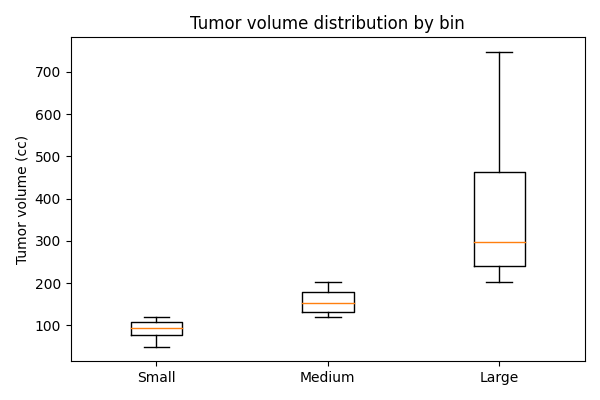

In [9]:
import matplotlib.pyplot as plt
import numpy as np

# --- assuming you already have: tumor_volumes (shape [N]) ---

# Define tertiles and assign bins if not already done
q1, q2 = np.quantile(tumor_volumes, [1/3, 2/3])

tv_bins = np.zeros_like(tumor_volumes, dtype=int)
tv_bins[tumor_volumes > q1] = 1
tv_bins[tumor_volumes > q2] = 2

# Group volumes by bin
groups = [tumor_volumes[tv_bins == k] for k in range(3)]
labels = ["Small", "Medium", "Large"]

# Boxplot (good for skewed data)
plt.figure(figsize=(6, 4))
plt.boxplot(groups, labels=labels, showfliers=False)
plt.ylabel("Tumor volume (cc)")
plt.title("Tumor volume distribution by bin")
plt.tight_layout()
plt.show()

In [10]:
from sklearn.model_selection import StratifiedShuffleSplit

# use indices [0, 1, ..., N-1] as our "patient IDs"
idx = np.arange(N)

sss = StratifiedShuffleSplit(
    n_splits=1,
    test_size=40,       # you want exactly 40 patients in test
    random_state=42,
)

# X can be dummy; y is tv_bins for stratification
dummy_X = np.zeros((N, 1))
train_pos, test_pos = next(sss.split(dummy_X, tv_bins))

train_idx = idx[train_pos]
test_idx  = idx[test_pos]

print("Train size:", len(train_idx), "Test size:", len(test_idx))

train_subjects = [full_subjects[i] for i in train_idx]
test_subjects  = [full_subjects[i] for i in test_idx]

# Check that the volume-bin distribution is similar
print("Train bin distribution:",
      np.unique(tv_bins[train_idx], return_counts=True))
print("Test bin distribution:",
      np.unique(tv_bins[test_idx], return_counts=True))

Train size: 110 Test size: 40
Train bin distribution: (array([0, 1, 2]), array([37, 37, 36], dtype=int64))
Test bin distribution: (array([0, 1, 2]), array([13, 13, 14], dtype=int64))


Train counts per bin: {'Small': 37, 'Medium': 37, 'Large': 36}
Test  counts per bin: {'Small': 13, 'Medium': 13, 'Large': 14}


<IPython.core.display.Javascript object>


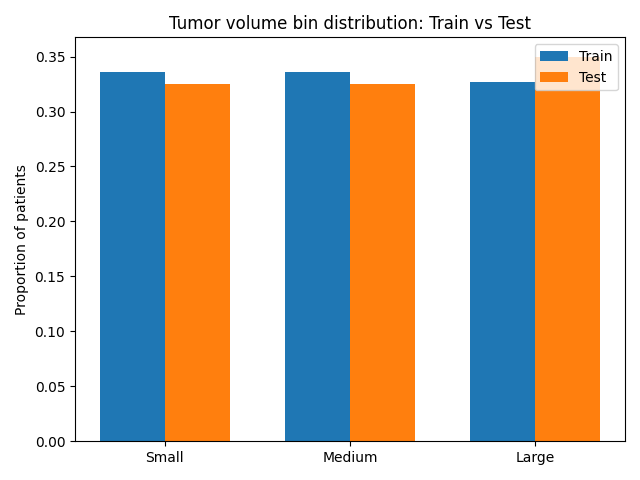

In [11]:
import numpy as np
import matplotlib.pyplot as plt

# --- define labels for bins (must match how you defined tv_bins) ---
bin_ids   = np.array([0, 1, 2])
bin_names = ["Small", "Medium", "Large"]

# bin labels in train/test sets
train_bins = tv_bins[train_idx]
test_bins  = tv_bins[test_idx]

# counts per bin
train_counts = np.array([(train_bins == b).sum() for b in bin_ids])
test_counts  = np.array([(test_bins  == b).sum() for b in bin_ids])

# convert to proportions (optional but usually more informative)
train_frac = train_counts / train_counts.sum()
test_frac  = test_counts  / test_counts.sum()

print("Train counts per bin:", dict(zip(bin_names, train_counts)))
print("Test  counts per bin:", dict(zip(bin_names, test_counts)))

# --- bar plot of proportions per bin ---
x = np.arange(len(bin_ids))
width = 0.35

plt.figure()
plt.bar(x - width/2, train_frac, width, label="Train")
plt.bar(x + width/2, test_frac,  width, label="Test")

plt.xticks(x, bin_names)
plt.ylabel("Proportion of patients")
plt.title("Tumor volume bin distribution: Train vs Test")
plt.legend()
plt.tight_layout()
plt.show()

## Stratified 5-fold CV inside the training patients

In [12]:
import numpy as np
from sklearn.model_selection import StratifiedKFold

n_splits = 5

# make sure train_idx is a NumPy array of global indices
train_idx = np.array(train_idx)

# stratification labels restricted to training patients
train_bins = tv_bins[train_idx]

skf = StratifiedKFold(
    n_splits=n_splits,
    shuffle=True,
    random_state=123,
)

folds = []
for fold_id, (train_pos, val_pos) in enumerate(skf.split(train_idx, train_bins)):
    # train_pos, val_pos are *positions* inside train_idx
    tr_idx_f  = train_idx[train_pos]   # global indices for this fold's train set
    val_idx_f = train_idx[val_pos]     # global indices for this fold's val set

    folds.append((tr_idx_f, val_idx_f))
    print(f"Fold {fold_id}: train={len(tr_idx_f)}, val={len(val_idx_f)}")

# Example: build Subjects lists per fold
fold_subjects = []
for f, (tr_idx_f, val_idx_f) in enumerate(folds):
    tr_subjs  = [full_subjects[i] for i in tr_idx_f]
    val_subjs = [full_subjects[i] for i in val_idx_f]
    fold_subjects.append((tr_subjs, val_subjs))

Fold 0: train=88, val=22
Fold 1: train=88, val=22
Fold 2: train=88, val=22
Fold 3: train=88, val=22
Fold 4: train=88, val=22


Validation bin counts per fold:
Fold 0: {'Small': 7, 'Medium': 7, 'Large': 8}
Fold 1: {'Small': 7, 'Medium': 8, 'Large': 7}
Fold 2: {'Small': 7, 'Medium': 8, 'Large': 7}
Fold 3: {'Small': 8, 'Medium': 7, 'Large': 7}
Fold 4: {'Small': 8, 'Medium': 7, 'Large': 7}


<IPython.core.display.Javascript object>


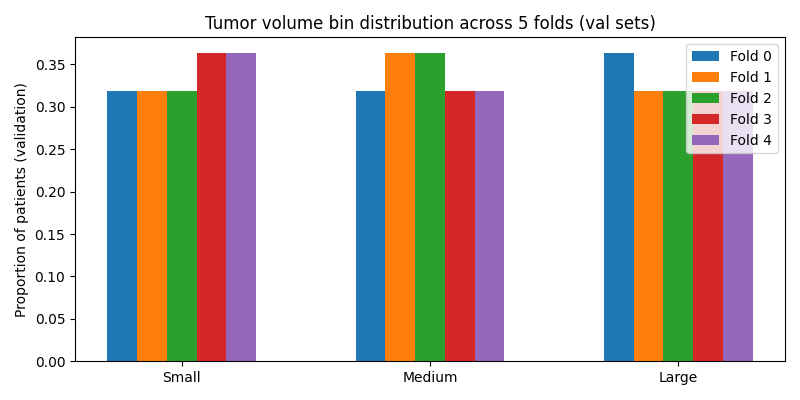

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# --- config ----
bin_ids   = np.array([0, 1, 2])
bin_names = ["Small", "Medium", "Large"]

n_folds = len(folds)

# val_counts[f, b] = number of patients in bin b in fold f (validation set)
val_counts = np.zeros((n_folds, len(bin_ids)), dtype=int)

for f, (_, val_idx_f) in enumerate(folds):  # tr_idx_f not needed for this plot
    val_bins_f = tv_bins[val_idx_f]        # tv_bins is over all subjects (length N)
    for j, b in enumerate(bin_ids):
        val_counts[f, j] = np.sum(val_bins_f == b)

# Convert to proportions per fold (optional but recommended)
val_totals = val_counts.sum(axis=1, keepdims=True)
val_frac = val_counts / val_totals.astype(float)

print("Validation bin counts per fold:")
for f in range(n_folds):
    print(f"Fold {f}:",
          {name: int(val_counts[f, j]) for j, name in enumerate(bin_names)})

# --- Plot: grouped bar chart of proportions ---
x = np.arange(len(bin_ids))
width = 0.12  # bar width per fold

plt.figure(figsize=(8, 4))
for f in range(n_folds):
    plt.bar(
        x + (f - (n_folds - 1) / 2) * width,
        val_frac[f],
        width,
        label=f"Fold {f}"
    )

plt.xticks(x, bin_names)
plt.ylabel("Proportion of patients (validation)")
plt.title("Tumor volume bin distribution across 5 folds (val sets)")
plt.legend()
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


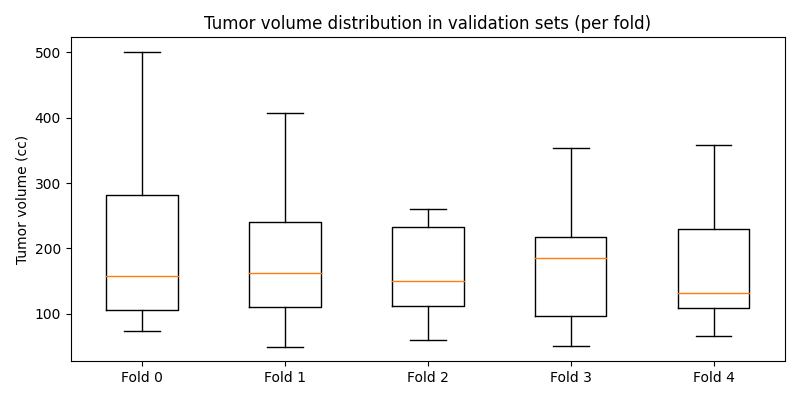

In [14]:
import numpy as np
import matplotlib.pyplot as plt

# Number of folds (based on the folds list from StratifiedKFold)
n_folds = len(folds)

# Collect validation tumor volumes per fold
fold_val_vols = [
    tumor_volumes[val_idx_f] for (_, val_idx_f) in folds
    # val_idx_f are global indices; tumor_volumes is a 1D NumPy array of length N
]

plt.figure(figsize=(8, 4))
plt.boxplot(
    fold_val_vols,
    labels=[f"Fold {i}" for i in range(n_folds)],
    showfliers=False
)
plt.ylabel("Tumor volume (cc)")
plt.title("Tumor volume distribution in validation sets (per fold)")
plt.tight_layout()
plt.show()

## Define root and save test set and 5-fold training subfolders

In [15]:
import shutil
from pathlib import Path

# full_subjects: list of TorchIO Subjects
# train_idx, test_idx: global indices (from StratifiedShuffleSplit)
# folds: list of (tr_idx_f, val_idx_f) from StratifiedKFold, also global indices

# 1) where to write the split data
split_root = Path(r"E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split") / "splits"
split_root.mkdir(parents=True, exist_ok=True)


def copy_subjects(indices, base_dest_dir, full_subjects):
    """
    Copy CT and Label for given subject indices into:
      base_dest_dir/image/
      base_dest_dir/label_gtvp/
    keeping the original filenames.
    """
    base_dest_dir = Path(base_dest_dir)
    img_dest = base_dest_dir / "image"
    lbl_dest = base_dest_dir / "label_gtvp"
    img_dest.mkdir(parents=True, exist_ok=True)
    lbl_dest.mkdir(parents=True, exist_ok=True)

    for i in indices:
        subj = full_subjects[i]

        # CT
        ct_img = subj["CT"]
        ct_src = Path(ct_img.path)
        shutil.copy2(ct_src, img_dest / ct_src.name)

        # Label
        lbl_img = subj["Label"]
        lbl_src = Path(lbl_img.path)
        shutil.copy2(lbl_src, lbl_dest / lbl_src.name)


# 2) Save TEST set (single set, no folds)
test_dir = split_root / "test"
copy_subjects(test_idx, test_dir, full_subjects)
print("Saved test set to:", test_dir)


# 3) Save TRAIN folds (5 subfolders with train/val)
for fold_id, (tr_idx_f, val_idx_f) in enumerate(folds):
    fold_root   = split_root / "train" / f"fold{fold_id}"
    train_dir_f = fold_root / "train"
    val_dir_f   = fold_root / "val"

    copy_subjects(tr_idx_f,  train_dir_f, full_subjects)
    copy_subjects(val_idx_f, val_dir_f,   full_subjects)

    print(f"Fold {fold_id}: saved {len(tr_idx_f)} train and {len(val_idx_f)} val subjects to {fold_root}")

Saved test set to: E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\test
Fold 0: saved 88 train and 22 val subjects to E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\train\fold0
Fold 1: saved 88 train and 22 val subjects to E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\train\fold1
Fold 2: saved 88 train and 22 val subjects to E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\train\fold2
Fold 3: saved 88 train and 22 val subjects to E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\train\fold3
Fold 4: saved 88 train and 22 val subjects to E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\splits\train\fold4


In [16]:
import numpy as np

def reorient2d(slice2d: np.ndarray) -> np.ndarray:
    """Flip vertically, then rotate -90° (clockwise)."""
    s = np.flipud(slice2d)
    s = np.rot90(s, k=3)
    return s

def reorient_vol(vol: np.ndarray) -> np.ndarray:
    """Apply the same 2D reorient to every axial slice of a (H,W,D) volume."""
    # flip along H (axis 0), then rotate -90° in (H,W) plane
    return np.rot90(np.flip(vol, axis=0), k=3, axes=(0, 1))

<IPython.core.display.Javascript object>


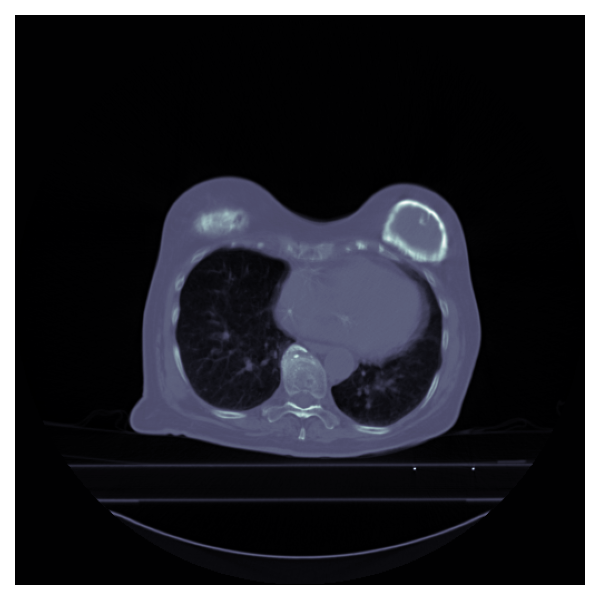

In [17]:
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
from celluloid import Camera
from pathlib import Path

# -------- paths & loading --------
# Root of your current data
root = Path(r"E:\DoNotTouch\projects\LANSCLC\CIS_5810\selected_150_split\full")

# choose a case, e.g. Lung_008
pid = "Lung_014"

ct_path   = root / "image"      / f"{pid}_0000.nii.gz"   # e.g. Lung_008_0000.nii.gz
mask_path = root / "label_gtvp" / f"{pid}.nii.gz"        # e.g. Lung_008.nii.gz

ct_nii   = nib.load(str(ct_path))
mask_nii = nib.load(str(mask_path))

ct   = ct_nii.get_fdata()
mask = mask_nii.get_fdata()

# -------- reorient & animate --------
ct_r   = reorient_vol(ct.astype(np.float32, copy=False))
mask_r = reorient_vol(mask).astype(bool, copy=False)  # keep mask boolean

fig, ax = plt.subplots(figsize=(6, 6))
camera = Camera(fig)

for i in range(ct_r.shape[2]):          # axial slices
    # extract slice
    ct_slice   = ct_r[:, :, i]
    mask_slice = mask_r[:, :, i]

    ax.imshow(ct_slice, cmap="bone", origin="upper")
    overlay = np.ma.masked_where(~mask_slice, mask_slice)
    ax.imshow(overlay, alpha=0.5, cmap="autumn", origin="upper")
    ax.set_axis_off()
    camera.snap()

plt.tight_layout()
animation = camera.animate(interval=80)    # ~12.5 fps

# To display in a notebook:
# from IPython.display import HTML
# HTML(animation.to_jshtml())

# Or to save:
# animation.save(r"E:\DoNotTouch\projects\LANSCLC\CIS_5810\ct_mask.gif",
#                writer="pillow", fps=12)

In [18]:
from IPython.display import HTML
# one-liner swap:
HTML(animation.to_jshtml())   # instead of animation.to_html5_video()